Example for using a robot with a "Shape
=======================================


Version | Author
------------ | -------------
0.1 | Björn Hein

License is based on Creative Commons: Attribution-NonCommercial 4.0 International (CC BY-NC 4.0) (pls. check: http://creativecommons.org/licenses/by-nc/4.0/)

# 2Dof-Robot with Shape
Create a Robot with a shape and 2-Dof 

In [1]:
from IPEnvironmentShapeRobot import CollisionCheckerShapeRobot
from IPEnvironmentShapeRobot import ShapeRobot, ShapeRobotWithOrientation
from shapely.geometry import Point, Polygon, LineString
from shapely.affinity import scale, translate
import matplotlib.pyplot as plt

import numpy as np



# Definition of a testing environment
obs1 = LineString([(5,18),(5,8),(20,8),(20,18)]).buffer(1.0)
obs2 = LineString([(15,15), (15,25), (30,25), (30,10)]).buffer(1.0)

# obs2 = scale(obs1, yfact=-1, origin='center')
# obs2 = translate(obs2, xoff=10, yoff=7)
trapField = dict()
trapField["obs1"] = obs1
trapField["obs2"] = obs2

# define robot geometry
robot_shape = Polygon([
    (-0.5, -0.5),  # unten links
    (3, -0.5),     # unten rechts
    (3, 0.0),      # Innenknick rechts
    (0.5, 0.0),    # Innenknick unten horizontal
    (0.5, 1.0),    # oben links vom L-Schenkel
    (-0.5, 1.0)    # oben links außen
])
shape_robot = ShapeRobot(robot_shape, limits=[[0.0, 22.0], [0.0, 22.0]])

Use an adapted CollisionChecker for the shaped robot

In [2]:
environment = CollisionCheckerShapeRobot(trapField, shape_robot)

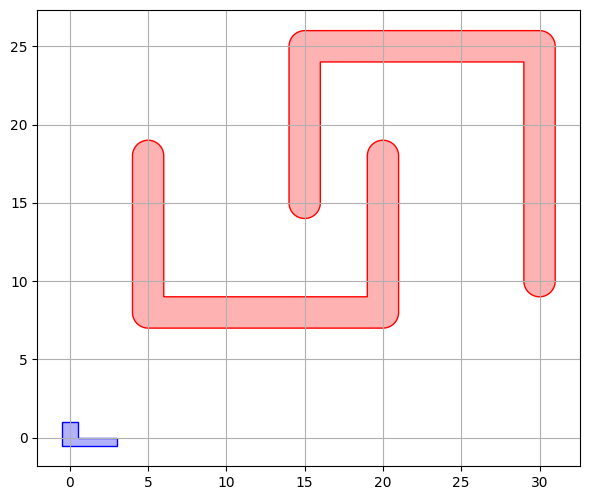

In [3]:
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
environment.drawObstacles(ax)

## Testing planning

/home/anton/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


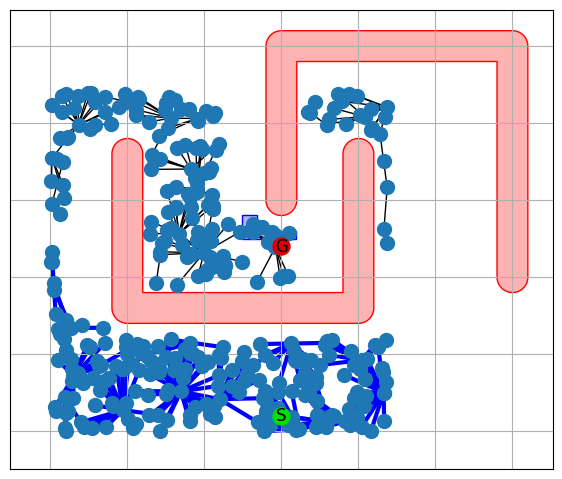

In [4]:
from IPBasicPRM import BasicPRM
from IPVISBasicPRM import basicPRMVisualize


basicPRM = BasicPRM(environment)
basicConfig = dict()
basicConfig["radius"] = 3
basicConfig["numNodes"] = 350

start = [[15,1]]
goal  = [[15,12]]

solution = basicPRM.planPath(start, goal, basicConfig)

fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
basicPRMVisualize(basicPRM,solution,ax=ax)



## Drawing the collsion space

In [5]:
environment
myBot = environment.robot
limits = myBot.getLimits()
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
print(limits)
for x in np.linspace(limits[0][0],limits[0][1],80):
    for y in np.linspace(limits[1][0],limits[1][1],80):
        if (environment.pointInCollision([x,y])):
            # draw in blue and transparent
            ax.scatter(x,y,marker="o", color="red", alpha=0.1)
environment.drawObstacles(ax)


[[0.0, 22.0], [0.0, 22.0]]
Error in callback <function flush_figures at 0x7bd0052ebeb0> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

## Visualize C-Space in combination with W-Space

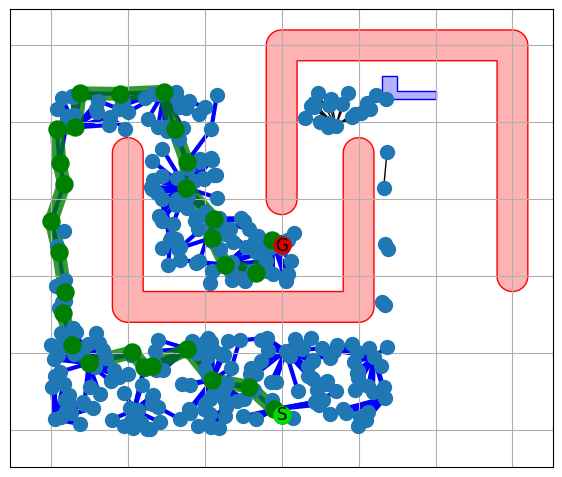

In [ ]:
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
basicPRMVisualize(basicPRM,solution,ax=ax)

**Remark**: The robot is in the CollisionCheckerShapeRobot - Environment. The visualize-function basically draws the robot at it's current position. Therefore it is possible to set the robot position before drawing:

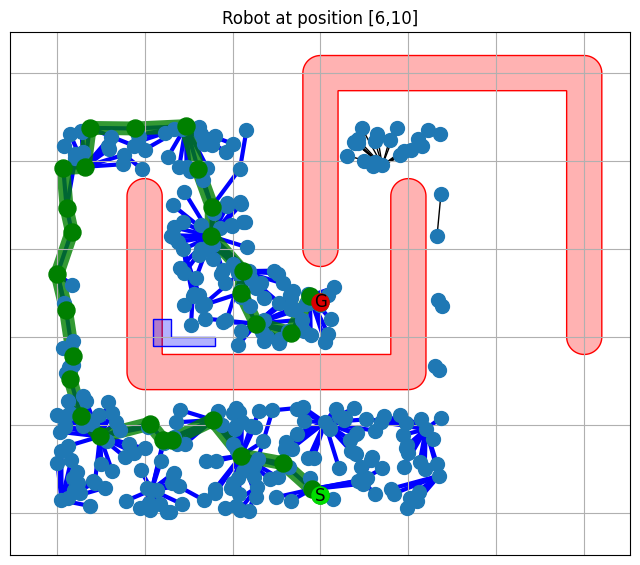

In [ ]:
robot = environment.robot
robot.setTo([6,10])

fig_local = plt.figure(figsize=(8,8))
ax = fig_local.add_subplot(1,1,1)
ax.set_title("Robot at position [6,10]")
basicPRMVisualize(basicPRM,solution,ax=ax)

## Create an animation

In [11]:
import copy
def interpolate_line(startPos, endPos, step_l):
    steps = []
    line = np.array(endPos) - np.array(startPos)
    line_l = np.linalg.norm(line)
    step = line / line_l * step_l
    n_steps = np.floor(line_l / step_l).astype(np.int32)
    c_step = np.array(startPos, dtype=np.float32)
    for i in range(n_steps):
        steps.append(copy.deepcopy(c_step))
        c_step += step
    if not (c_step == np.array(endPos)).all():
        steps.append(np.array(endPos))
    return steps


Extract the positions from the solutioExtract the positions from the solution path. The solution contains the names of the nodes in the graph, that are part of the solution path.

In [ ]:
solution

['start',
 10,
 55,
 7,
 12,
 105,
 26,
 51,
 15,
 35,
 177,
 33,
 65,
 31,
 60,
 1,
 287,
 6,
 8,
 49,
 3,
 19,
 14,
 2,
 44,
 50,
 46,
 54,
 52,
 'goal']

To get the position of a node base on the name use:

In [ ]:
basicPRM.graph.nodes[solution[1]]["pos"]

[14.517475908160046, 1.3407006572660065]

To get all positions in a list:

In [ ]:
solution_pos = [basicPRM.graph.nodes[node]['pos'] for node in solution]
solution_pos

[[15, 1],
 [14.517475908160046, 1.3407006572660065],
 [12.872138785360136, 2.818301539828036],
 [10.497867272220647, 3.253821360564067],
 [8.88090379165092, 5.272711672338008],
 [6.550180005747413, 4.14547139675682],
 [6.070734120408929, 4.109241216173151],
 [5.299466883553264, 5.061865607668976],
 [2.4605991272346537, 4.33674582781685],
 [1.3765582033413555, 5.504690480541164],
 [0.7800545121720757, 7.603165670803477],
 [0.9205184701130984, 8.940045754109876],
 [0.5262515968704351, 11.549203422573118],
 [0.04228293465700439, 13.596681671603516],
 [0.8590293593612104, 15.98885759121574],
 [0.5664821851209156, 17.3263945689735],
 [0.37426814878791714, 19.590851198144044],
 [1.590167591034984, 19.671286693628193],
 [1.8781834533180928, 21.883161078843095],
 [4.46273661237017, 21.850993062463136],
 [7.346637529239162, 21.98576872477215],
 [8.039968780240896, 19.55736527915168],
 [8.82210329792203, 17.40370273654062],
 [8.802255520494422, 15.721949933093894],
 [10.572567959857604, 13.73322

Create the animation:

Attention in the following code there is  

**matplotlib.rcParams['animation.embed_limit'] = 128**

If the parameter is chosen to small the animation will stop in the middle of the path.

The call to interplate_line contains at the end a double for the granularity of the interpolation!



In [ ]:
import matplotlib.animation
matplotlib.rcParams['animation.embed_limit'] = 128
from IPython.display import HTML, display

planner=basicPRM

fig_local = plt.figure(figsize=(7, 7))
ax = fig_local.add_subplot(1, 1, 1)
## get positions for solution
solution_pos = [planner.graph.nodes[node]['pos'] for node in solution]
## interpolate to obtain a smoother movement
i_solution_pos = [solution_pos[0]]
for i in range(1, len(solution_pos)):
    segment_s = solution_pos[i-1]
    segment_e = solution_pos[i]
    # choose granularity of interpolation here
    i_solution_pos = i_solution_pos + interpolate_line(segment_s, segment_e, 0.5)[1:]
## animate
frames = len(i_solution_pos)

r = environment.robot
workSpaceLimits = environment.robot.getLimits()

def animate(t):
    ## clear taks space figure
    ax.cla()
    ## fix figure size
    ax.set_xlim(workSpaceLimits[0])
    ax.set_ylim(workSpaceLimits[1])
    ## draw obstacles
    #environment.drawObstacles(ax)
    ## update robot position
    pos = i_solution_pos[t]
    r.setTo(pos)
    basicPRMVisualize(basicPRM,solution,ax=ax)
    

ani = matplotlib.animation.FuncAnimation(fig_local, animate, frames=frames)
html = HTML(ani.to_jshtml())
display(html)
plt.close()



/home/anton/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


## Robot with orientation
Same as before but now the robot can also rotate

In [14]:
import math
# define robot geometry
shape_robot = ShapeRobot(robot_shape, limits=[[0.0, 22.0], [0.0, 22.0]])
robot_shape2 = robot_shape
shape_robot2 = ShapeRobotWithOrientation(robot_shape2, limits=[[0.0, 22.0,], [0.0, 22.0], [-math.pi, math.pi]])
environment = CollisionCheckerShapeRobot(trapField, shape_robot2)

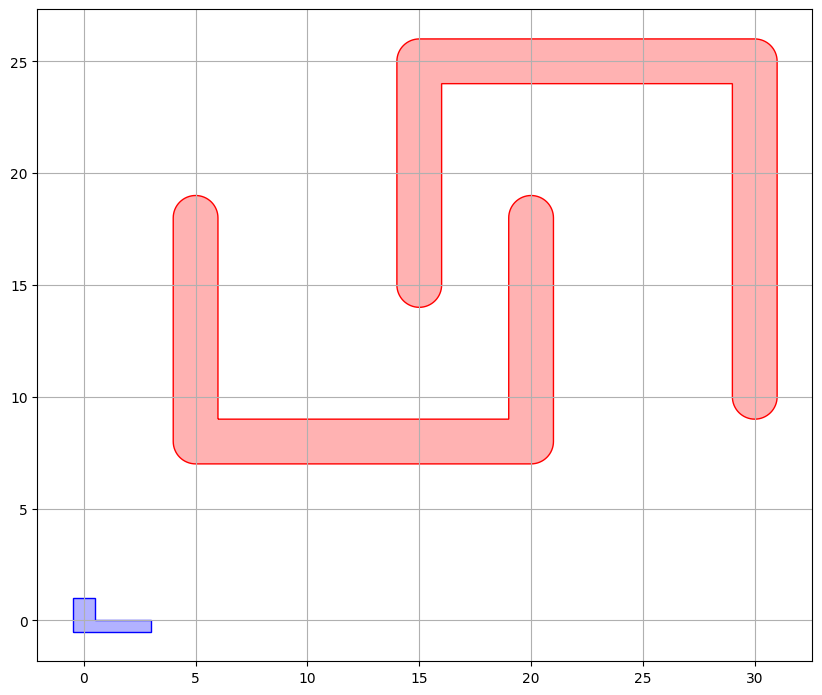

In [15]:
fig_local = plt.figure(figsize=(10,10))
ax = fig_local.add_subplot(1,1,1)
environment.drawObstacles(ax)

In [8]:
basicPRM = BasicPRM(environment)
basicConfig = dict()
basicConfig["radius"] = 5
basicConfig["numNodes"] = 350

start = [[25,5,0]]
goal  = [[15,12,0]]

solution = basicPRM.planPath(start, goal, basicConfig)
if len(solution) == 0:
    print("No solution found")

solution

['start',
 61,
 1,
 119,
 2,
 23,
 28,
 48,
 18,
 93,
 34,
 13,
 53,
 30,
 103,
 7,
 25,
 12,
 'goal']

Use for drawing the basicPRMVisualizeWspace. It basically draws the obstacles with robot with current position and orientation and uses only the first two coordinates to draw the graph, omitting the value for the orientation.

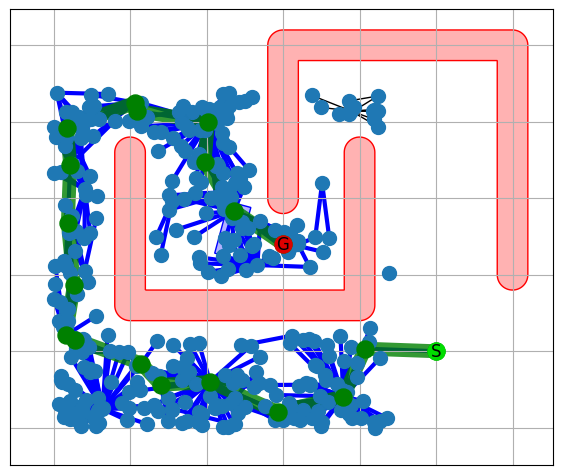

In [9]:
from IPVISBasicPRM import basicPRMVisualizeWspace
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
basicPRMVisualizeWspace(basicPRM,solution,ax=ax)

Create animation can take longer...

In [12]:
import matplotlib.animation
matplotlib.rcParams['animation.embed_limit'] = 256
from IPython.display import HTML, display

planner=basicPRM

fig_local = plt.figure(figsize=(7, 7))
ax = fig_local.add_subplot(1, 1, 1)
## get positions for solution
solution_pos = [planner.graph.nodes[node]['pos'] for node in solution]
## interpolate to obtain a smoother movement
i_solution_pos = [solution_pos[0]]
for i in range(1, len(solution_pos)):
    segment_s = solution_pos[i-1]
    segment_e = solution_pos[i]
    i_solution_pos = i_solution_pos + interpolate_line(segment_s, segment_e, 0.5)[1:]
## animate
frames = len(i_solution_pos)

r = environment.robot
workSpaceLimits = environment.robot.getLimits()

def animate(t):
    ## clear taks space figure
    ax.cla()
    ## fix figure size
    ax.set_xlim(workSpaceLimits[0])
    ax.set_ylim(workSpaceLimits[1])
    ## draw obstacles
    #environment.drawObstacles(ax)
    ## update robot position
    pos = i_solution_pos[t]
    r.setTo(pos)
    basicPRMVisualizeWspace(basicPRM,solution,ax=ax)
    

ani = matplotlib.animation.FuncAnimation(fig_local, animate, frames=frames)
html = HTML(ani.to_jshtml())
display(html)
plt.close()



/home/anton/.local/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


## Visibility RPM

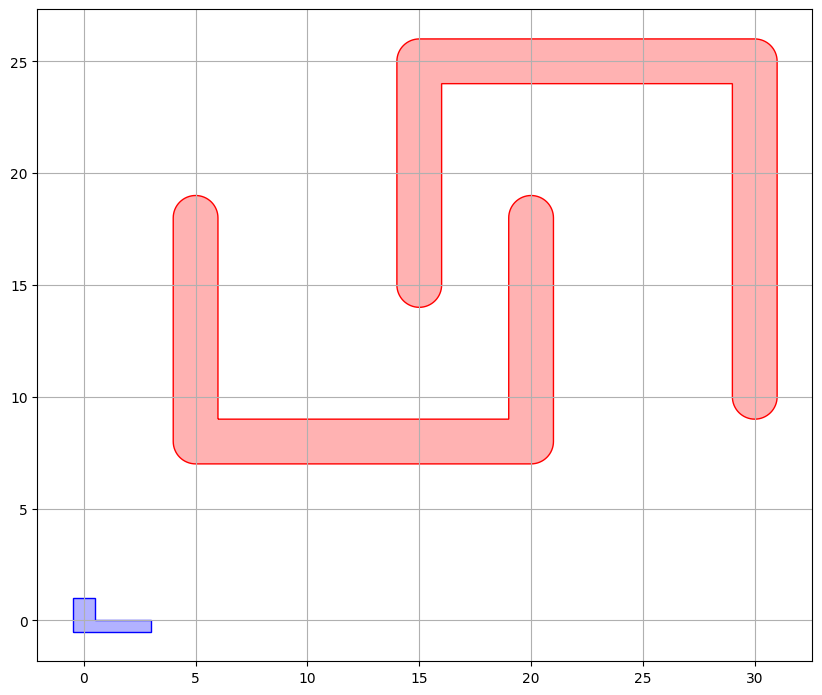

In [21]:
# define robot geometry
shape_robot = ShapeRobotWithOrientation(robot_shape, limits=[[0.0, 22.0,], [0.0, 22.0], [-math.pi, math.pi]])
environment = CollisionCheckerShapeRobot(trapField, shape_robot)

fig_local = plt.figure(figsize=(10,10))
ax = fig_local.add_subplot(1,1,1)
environment.drawObstacles(ax)

In [26]:
from IPVisibilityPRM import VisPRM 

visPRM = VisPRM(environment)
visConfig = dict()
visConfig["radius"] = 5
visConfig["ntry"] = 50

start = [[25,5,0]]
goal  = [[15,12,0]]

solution = visPRM.planPath(start, goal, visConfig)
if len(solution) == 0:
    print("No solution found")

solution

['start', 61, 96, 0, 10, 1, 3, 2, 52, 45, 'goal']

ValueError: 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)

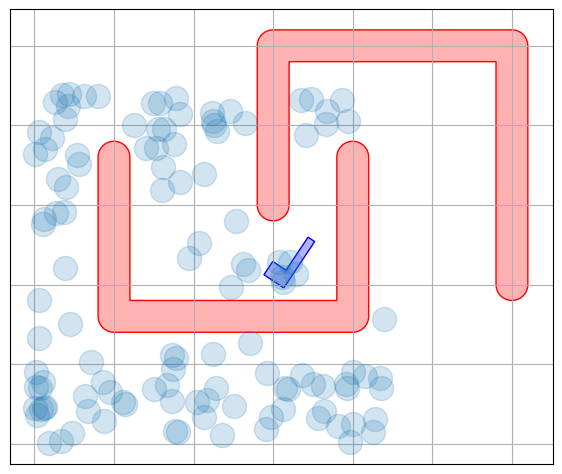

In [27]:
from IPVISVisibilityPRM import visibilityPRMVisualize
fig_local = plt.figure(figsize=(7,7))
ax = fig_local.add_subplot(1,1,1)
visibilityPRMVisualize(visPRM,solution,ax=ax)